In [1]:
from config import *
from dataset import *
from model import *
from train import *
from visualize import *

from sklearn.model_selection import train_test_split

%load_ext autoreload
%autoreload 2

/home/jichuanh/miniconda3/envs/open-mmlab/lib/python3.8/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
# Taining
BATCH_SIZE = 8
N_EPOCHS = 1
SWITCH_LOSS_EPOCH = 5
PRETRAINED = False

# model
BACKBONE = 'resnet18'
SUBMIT = False
PAPERMILL_INPUT_PATH = None
PAPERMILL_OUTPUT_PATH = None
TQDM_DISABLED = False

# model

FPN = False
CUT_AUG = None
COLOR_AUG = None
MASK_LOSS_TYPE = "default"
FLIP_AUG = False
SIDE_EXT = 4
# ONLY useful with bce
LABEL_SMOOTHING = 0.0
# starting learning rate
SCHEDULER = "Step"
LEARNING_RATE= 0.001
# used for multistep
MILESTONE = [0.6, 0.9]
CTIME_STR = None

# img and mask utils
DISTANCE_THRESH_CLEAR = 2
IMG_WIDTH = 1600
IMG_HEIGHT = (IMG_WIDTH // 16 * 5 + 32 // 2) // 32 * 32
MODEL_SCALE = 8
OPTIMIZE_XY = False


In [3]:
import pandas as pd
from datetime import datetime
train_images_dir = PATH + 'train_images/{}.jpg'
test_images_dir = PATH + 'test_images/{}.jpg'

train = pd.read_csv(PATH + 'train.csv')
bad_list = ['ID_1a5a10365',
'ID_1db0533c7',
'ID_53c3fe91a',
'ID_408f58e9f',
'ID_4445ae041',
'ID_bb1d991f6',
'ID_c44983aeb',
'ID_f30ebe4d4']
train = train.loc[~train['ImageId'].isin(bad_list)]

test = pd.read_csv(PATH + 'sample_submission.csv')

# TODO: split based on population
df_train, df_dev = train_test_split(train, test_size=0.1, random_state=63)
df_test = test

if CTIME_STR is None:
    CTIME_STR = datetime.now().strftime("%Y-%m-%d-%H-%M-%S")
    print("CTIME_STR not provided in injected params. Creating one: ", CTIME_STR)

# save all parmas in cfg with all cap names
cfg = {
    "BATCH_SIZE": BATCH_SIZE,
    "N_EPOCHS": N_EPOCHS,
    "SWITCH_LOSS_EPOCH": SWITCH_LOSS_EPOCH,
    "BACKBONE": BACKBONE,
    "SUBMIT": SUBMIT,
    "PAPERMILL_INPUT_PATH": PAPERMILL_INPUT_PATH,
    "PAPERMILL_OUTPUT_PATH": PAPERMILL_OUTPUT_PATH,
    "TQDM_DISABLED": TQDM_DISABLED,
    # AUG
    "PRETRAINED": PRETRAINED,
    "FPN": FPN,
    "CUT_AUG": CUT_AUG,
    "COLOR_AUG": COLOR_AUG,
    "FLIP_AUG": FLIP_AUG,
    "SIDE_EXT": SIDE_EXT,
    # LOSS
    "MASK_LOSS_TYPE": MASK_LOSS_TYPE,
    "LABEL_SMOOTHING": LABEL_SMOOTHING,
    "CTIME_STR": CTIME_STR,
    # SCHEDULER
    "SCHEDULER": SCHEDULER,
    "LEARNING_RATE": LEARNING_RATE,
    "MILESTONE": MILESTONE,
    # img and mask utils
    "DISTANCE_THRESH_CLEAR": DISTANCE_THRESH_CLEAR,
    "IMG_WIDTH": IMG_WIDTH,
    "IMG_HEIGHT": IMG_HEIGHT,
    "MODEL_SCALE": MODEL_SCALE,
    "OPTIMIZE_XY": False
}     

configured_utils = ConfiguredUtils(cfg)

CTIME_STR not provided in injected params. Creating one:  2024-01-10-02-36-21


test_img.shape:  (2710, 3384, 3)
Number of points inside: 48686
Number of points outside: 998


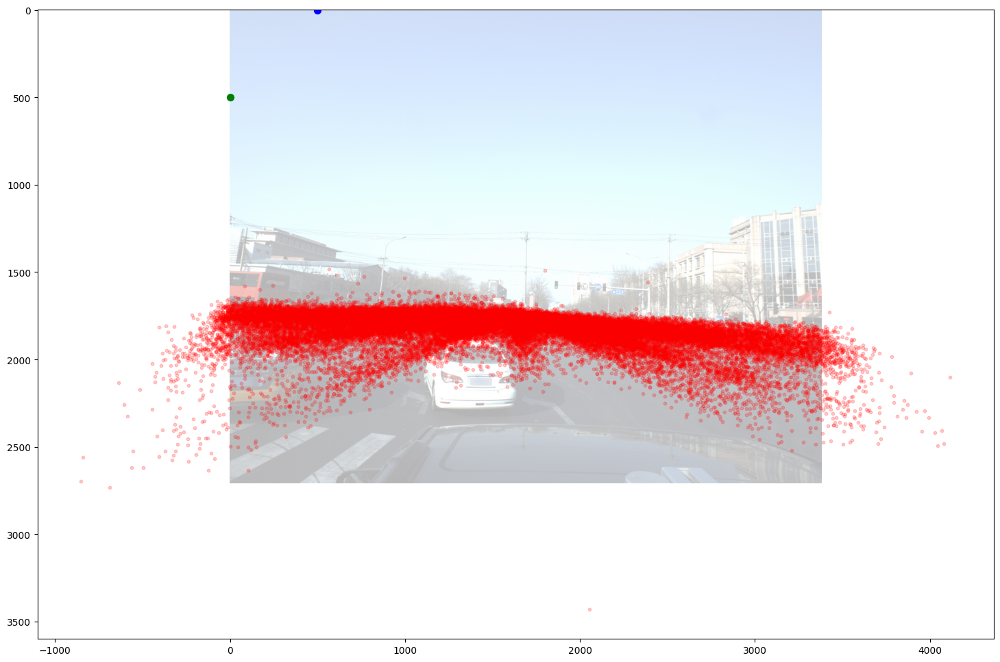

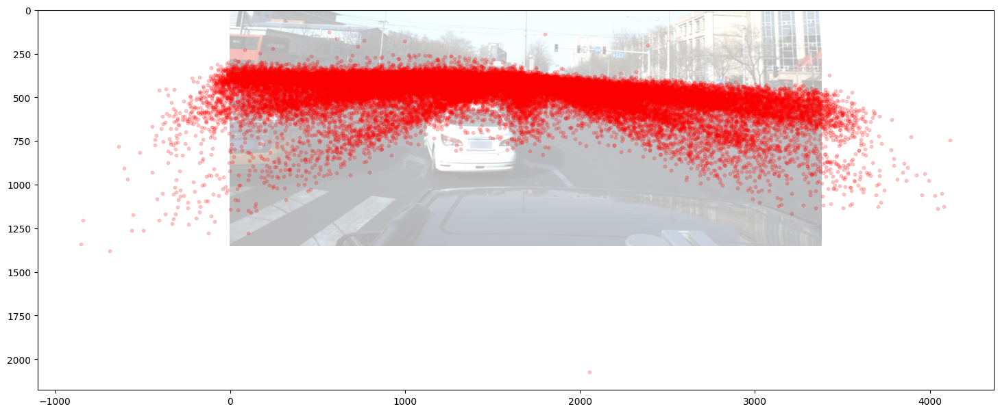

In [4]:
import matplotlib.pyplot as plt
train = pd.read_csv(PATH + 'train.csv')

xs, ys = [], []

for ps in train['PredictionString']:
    x, y = get_img_coords(ps)
    xs += list(x)
    ys += list(y)

test_img = imread(PATH + 'train_images/' + train['ImageId'][2217] + '.jpg')

print('test_img.shape: ', test_img.shape)
plt.figure(figsize=(18,18))
plt.imshow(test_img, alpha=0.3)
plt.scatter(xs, ys, color='red', s=10, alpha=0.2);
plt.scatter(500, 0, color='blue', s=50);
plt.scatter(0, 500, color='green', s=50);

# cut top half
test_img_half = test_img[IMG_SHAPE[0] // 2:, :, :]
ys_half = [y - IMG_SHAPE[0] // 2 for y in ys]
IMG_SHAPE_HALF = (IMG_SHAPE[0] // 2, IMG_SHAPE[1])

plt.figure(figsize=(18,18))
plt.imshow(test_img_half, alpha=0.3)
plt.scatter(xs, ys_half, color='red', s=10, alpha=0.2);

def count_inside(pts, img_shape):
    """
    pts: x, y -> x in width direction, y in height direction
    img_shape: (height, width)
    """
    return sum([0 <= x < img_shape[1] and 0 <= y < img_shape[0] for x, y in pts])

print(f"Number of points inside: {count_inside(zip(xs, ys_half), IMG_SHAPE_HALF)}")
print(f"Number of points outside: {len(xs) - count_inside(zip(xs, ys_half), IMG_SHAPE_HALF)}")

Number of points inside: 49666
Number of points outside: 18


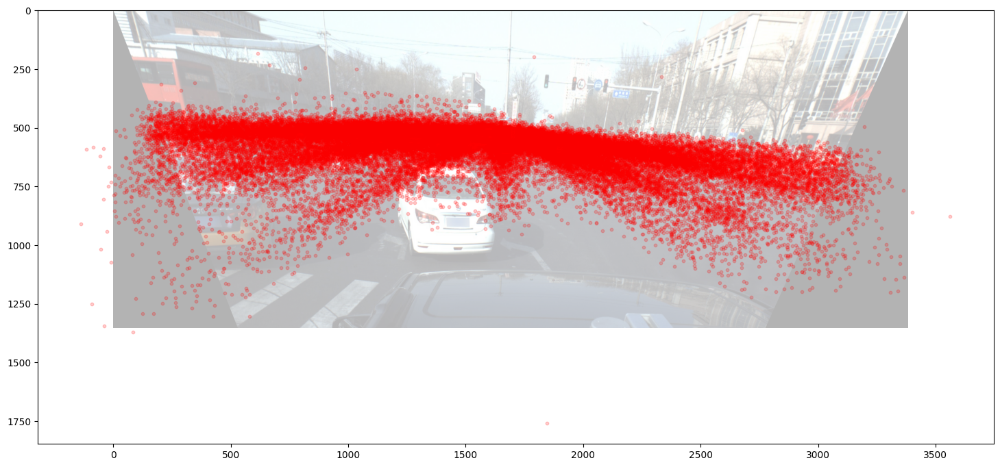

In [5]:
def get_points_from_boundary(left, right, top, bottom):
    return np.array([
        [left, top],
        [right, top],
        [right, bottom],
        [left, bottom]
    ])

target_pts = get_points_from_boundary(0, IMG_SHAPE_HALF[1], 0, IMG_SHAPE_HALF[0])

source_pts = np.array([
    [0, 0],
    [IMG_SHAPE_HALF[1], 0],
    [4300, IMG_SHAPE_HALF[0]],
    [-800, IMG_SHAPE_HALF[0]]
])

perspective_transform = cv2.getPerspectiveTransform(np.float32(source_pts), np.float32(target_pts))

test_img_half_transformed = cv2.warpPerspective(test_img_half, perspective_transform, (IMG_SHAPE_HALF[1], IMG_SHAPE_HALF[0]))
pts_transformed = cv2.perspectiveTransform(np.float32([xs, ys_half]).T[None, :, :], perspective_transform)[0]

plt.figure(figsize=(18,18))
plt.imshow(test_img_half_transformed, alpha=0.3)
plt.scatter(pts_transformed[:, 0], pts_transformed[:, 1], color='red', s=10, alpha=0.2);

# count the number of points inside
print(f"Number of points inside: {count_inside(pts_transformed, IMG_SHAPE_HALF)}")
print(f"Number of points outside: {len(pts_transformed) - count_inside(pts_transformed, IMG_SHAPE_HALF)}")

img.shape (512, 1600, 3) std: 0.28705373
mask.shape (64, 200) std: 0.019760378
regr.shape (64, 200, 7) std: 0.008355979


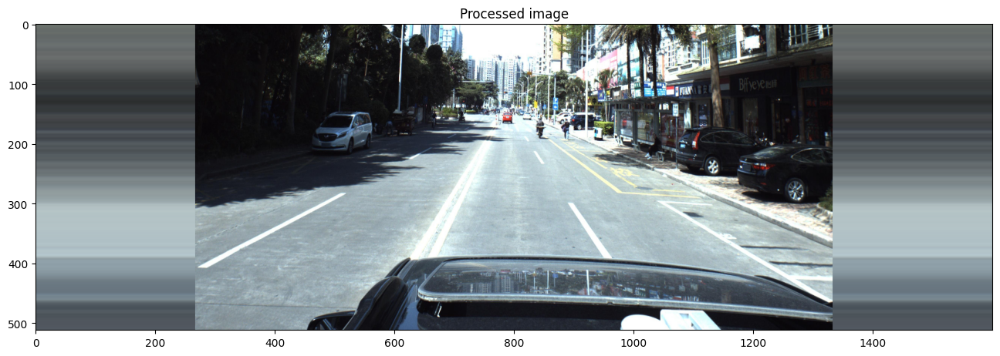

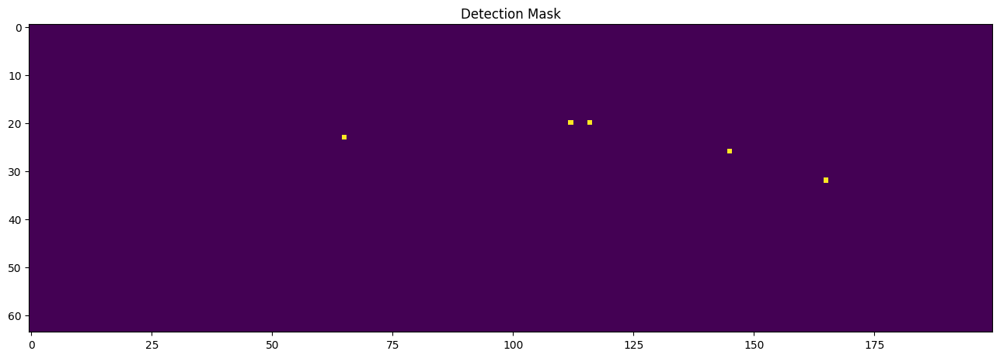

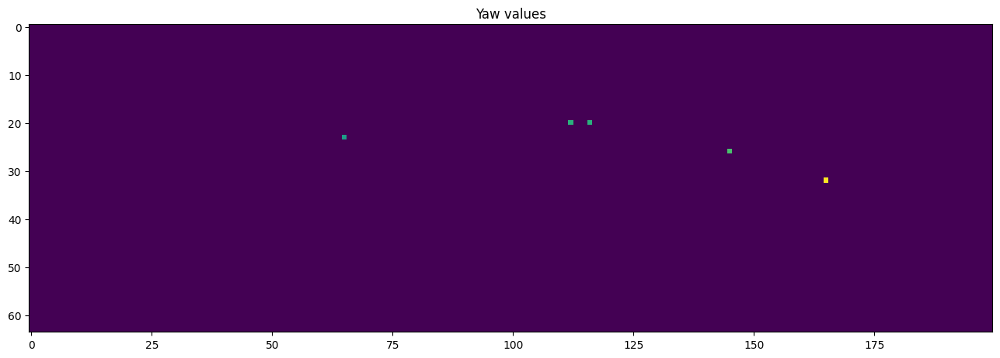

In [6]:
img0 = imread(PATH + 'train_images/' + train['ImageId'][0] + '.jpg')
img = configured_utils.preprocess_image(img0)

mask, regr = configured_utils.get_mask_and_regr(img0, train['PredictionString'][0])

print('img.shape', img.shape, 'std:', np.std(img))
print('mask.shape', mask.shape, 'std:', np.std(mask))
print('regr.shape', regr.shape, 'std:', np.std(regr))

plt.figure(figsize=(16,16))
plt.title('Processed image')
plt.imshow(img)
plt.show()

plt.figure(figsize=(16,16))
plt.title('Detection Mask')
plt.imshow(mask)
plt.show()

plt.figure(figsize=(16,16))
plt.title('Yaw values')
plt.imshow(regr[:,:,-2])
plt.show()

img.shape (512, 1600, 3) std: 0.3481198
mask.shape (64, 200) std: 0.019760376
regr.shape (64, 200, 7) std: 0.008355979


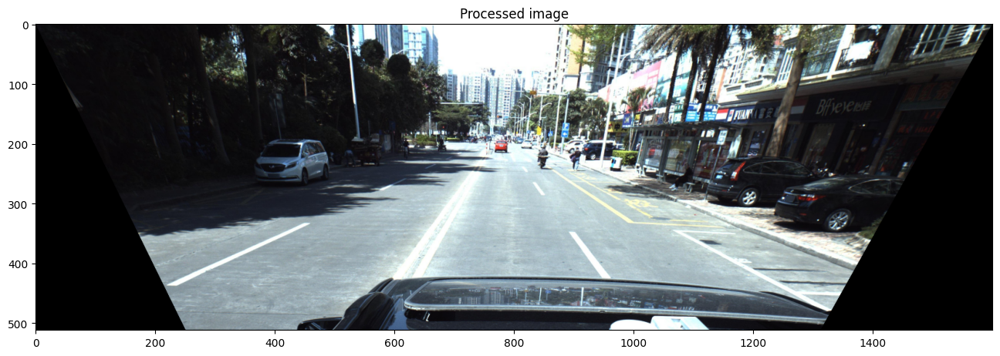

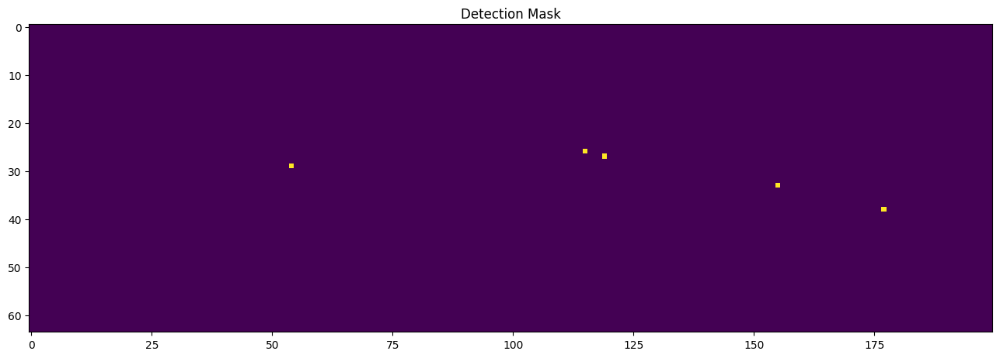

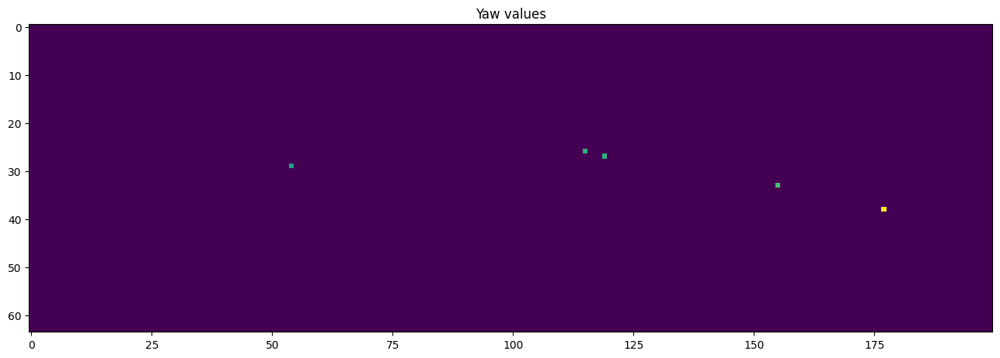

In [7]:
img0 = imread(PATH + 'train_images/' + train['ImageId'][0] + '.jpg')
img = configured_utils.preprocess_image(img0, perspective_transform=perspective_transform)

mask, regr = configured_utils.get_mask_and_regr(img0, train['PredictionString'][0], perspective_transform=perspective_transform)

print('img.shape', img.shape, 'std:', np.std(img))
print('mask.shape', mask.shape, 'std:', np.std(mask))
print('regr.shape', regr.shape, 'std:', np.std(regr))

plt.figure(figsize=(16,16))
plt.title('Processed image')
plt.imshow(img)
plt.show()

plt.figure(figsize=(16,16))
plt.title('Detection Mask')
plt.imshow(mask)
plt.show()

plt.figure(figsize=(16,16))
plt.title('Yaw values')
plt.imshow(regr[:,:,-2])
plt.show()

In [8]:
#papermill_description=DATA_AUG
import numpy as np
import albumentations  # albumentations >= 1.0.0
from albumentations import pytorch as AT
from dataset import randAugment

# TODO: add normalize?
train_transforms = albumentations.Compose([
    randAugment(color_aug=cfg["COLOR_AUG"], cut_aug=cfg["CUT_AUG"]),
    AT.ToTensorV2()
])

test_transform = albumentations.Compose([
    AT.ToTensorV2()
])

print(train_transforms)

Compose([
  Compose([
  ], p=1.0, bbox_params=None, keypoint_params=None, additional_targets={}, is_check_shapes=True),
  ToTensorV2(always_apply=True, p=1.0, transpose_mask=False),
], p=1.0, bbox_params=None, keypoint_params=None, additional_targets={}, is_check_shapes=True)


(64, 200)
(64, 200, 7)
[{'pitch_cos': -0.49252063, 'pitch_sin': -0.87030077, 'roll': -3.1175400001280984, 'x': 9.833350032567978, 'y': 13.268899917602539, 'yaw': 0.163068, 'z': 72.93230295181274, 'pitch': -2.0857799887062027, 'confidence': 0.7310585896677003}, {'pitch_cos': 0.002146325, 'pitch_sin': -0.9999977, 'roll': -3.1175400001280984, 'x': 10.39000004529953, 'y': 11.221899837255478, 'yaw': 0.163072, 'z': 59.78249907493591, 'pitch': -1.5686500000272892, 'confidence': 0.7310585896677003}, {'pitch_cos': -0.9999978, 'pitch_sin': -0.002092652, 'roll': 3.1196899992697915, 'x': -9.592360258102417, 'y': 5.136619880795479, 'yaw': 0.141942, 'z': 24.73369985818863, 'pitch': -3.1395000000066005, 'confidence': 0.7310585896677003}, {'pitch_cos': 0.10115303, 'pitch_sin': -0.9948709, 'roll': -3.1215899997674903, 'x': 9.603320062160492, 'y': 4.666319862008095, 'yaw': 0.181647, 'z': 19.338999688625336, 'pitch': -1.469470000449243, 'confidence': 0.7310585896677003}, {'pitch_cos': -0.84391725, 'pitch

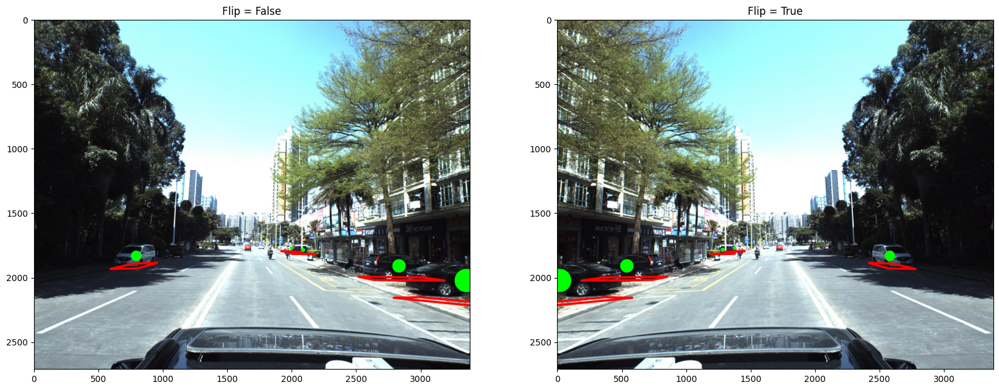

(64, 200)
(64, 200, 7)
[{'pitch_cos': -0.53581583, 'pitch_sin': 0.8443349, 'roll': -3.13968999998691, 'x': -44.58689987659454, 'y': 11.209099739789963, 'yaw': 0.195568, 'z': 62.98789978027344, 'pitch': 2.136270013298094, 'confidence': 0.7310585896677003}, {'pitch_cos': 0.87537134, 'pitch_sin': 0.48345122, 'roll': 3.139510000013285, 'x': -24.67550039291382, 'y': 18.29729974269867, 'yaw': 0.112481, 'z': 104.28800582885742, 'pitch': 0.5045929992540488, 'confidence': 0.7310585896677003}, {'pitch_cos': 0.9762449, 'pitch_sin': 0.21666986, 'roll': 3.122129999222704, 'x': -10.353100299835205, 'y': 11.245299875736237, 'yaw': 0.0209679, 'z': 63.71399760246277, 'pitch': 0.21840199825540568, 'confidence': 0.7310585896677003}, {'pitch_cos': -0.9571467, 'pitch_sin': -0.2896036, 'roll': -3.1339400002085647, 'x': -22.77110069990158, 'y': 13.070400059223175, 'yaw': 0.195428, 'z': 72.26939797401428, 'pitch': -2.8477800069022914, 'confidence': 0.7310585896677003}, {'pitch_cos': -0.98410714, 'pitch_sin': 

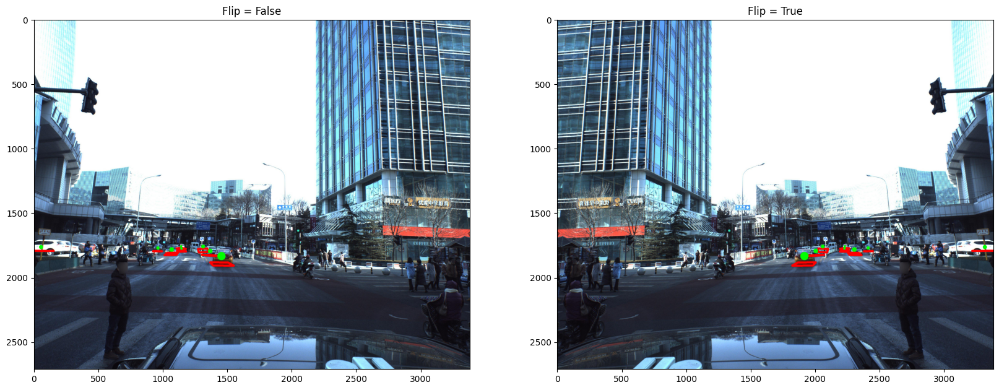

In [9]:
#papermill_description=FLIP_VISUALIZATION
for idx in range(2):
    fig, axes = plt.subplots(1, 2, figsize=(20,20))
    
    for ax_i in range(2):
        img0 = imread(PATH + 'train_images/' + train['ImageId'].iloc[idx] + '.jpg')
        if ax_i == 1:
            img0 = img0[:,::-1]
        img = configured_utils.preprocess_image(img0, ax_i==1)
        mask, regr = configured_utils.get_mask_and_regr(img0, train['PredictionString'][idx], ax_i==1)
        print(mask.shape)
        print(regr.shape)
        coords = configured_utils.extract_coords(np.concatenate([mask[:,:,None], regr], -1))
        print(coords)
        axes[ax_i].set_title('Flip = {}'.format(ax_i==1))
        axes[ax_i].imshow(visualize(img0, coords))
    plt.show()

torch.Size([3, 512, 1600])


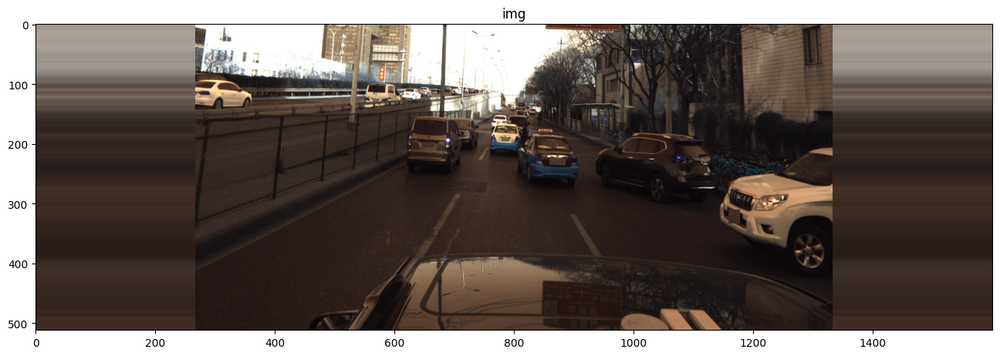

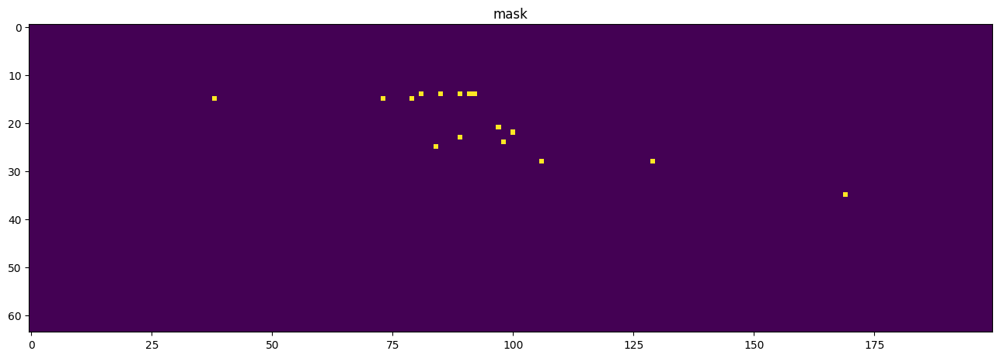

torch.Size([3, 512, 1600])


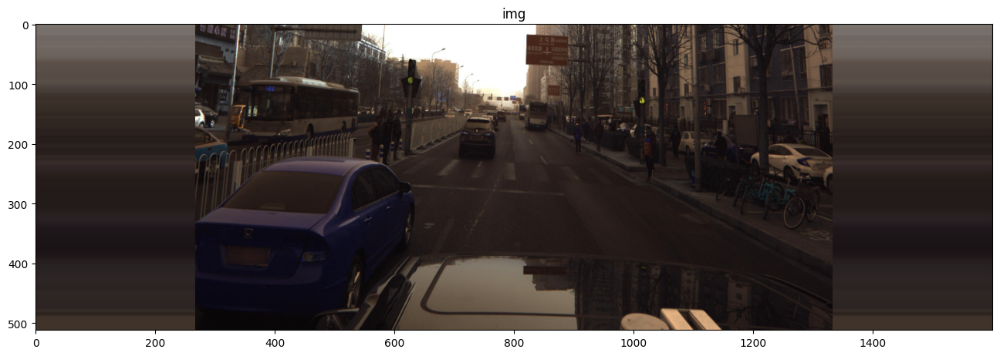

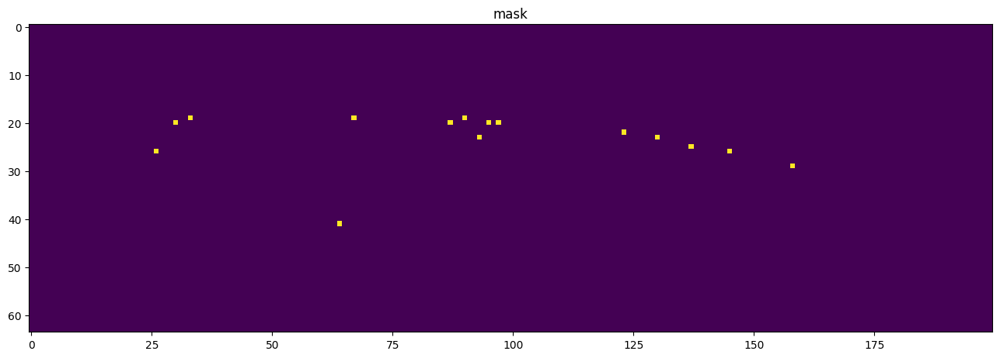

torch.Size([3, 512, 1600])


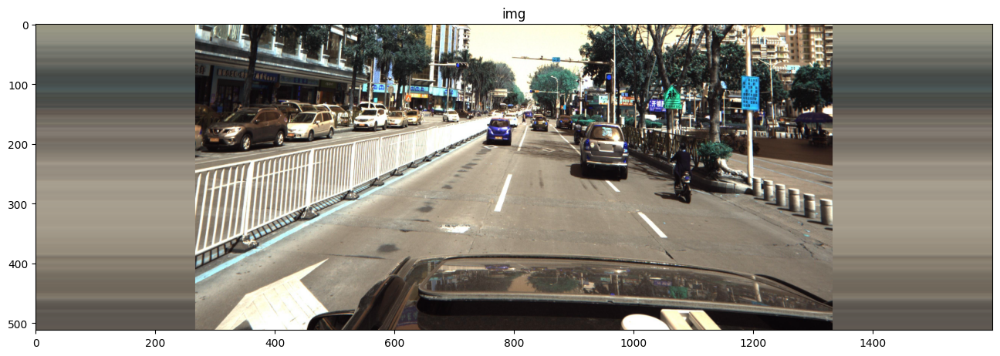

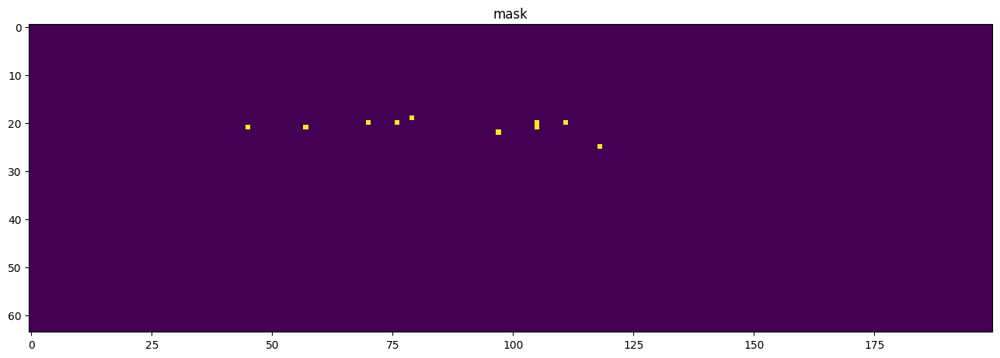

torch.Size([3, 512, 1600])


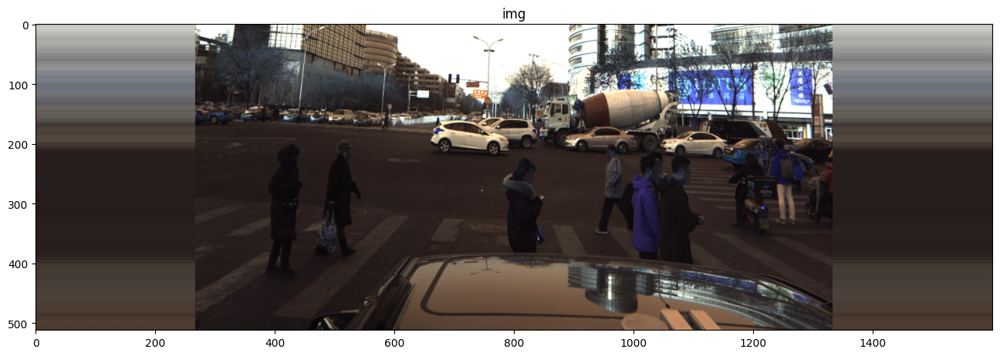

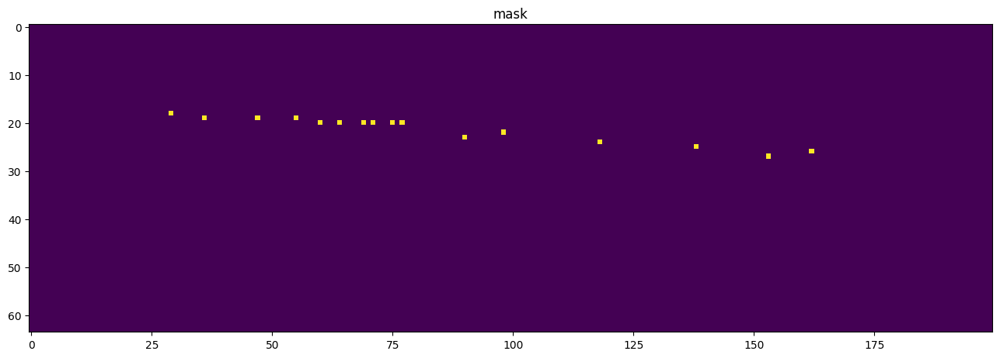

torch.Size([3, 512, 1600])


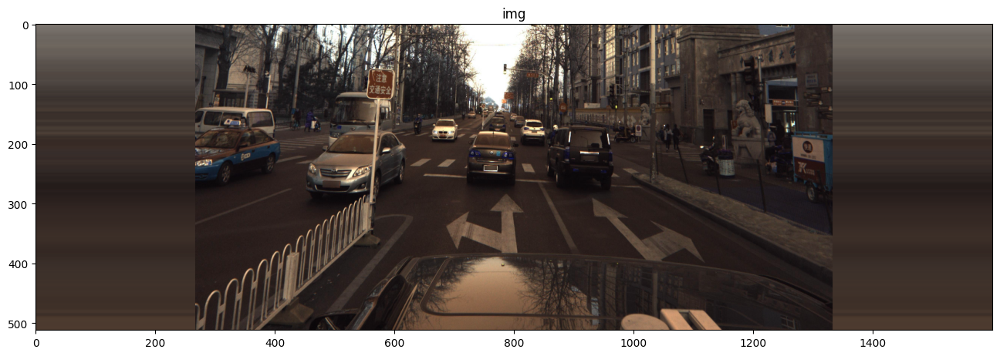

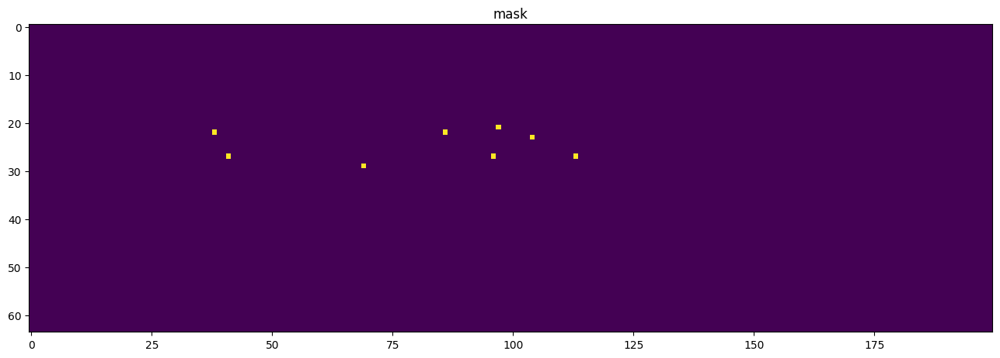

In [10]:
import random

test_tain_dataset = CarDataset(df_train, train_images_dir, cfg=cfg, training=True, transform=train_transforms)
# test augmentation
for i in range(5):
    t_img, t_mask, t_regr = test_tain_dataset[i]
    print(t_img.shape)
    plt.figure(figsize=(16,16))
    plt.title('img')
    
    plt.imshow(np.rollaxis(torch.Tensor.numpy(t_img), 0, 3))
    plt.show()
    plt.figure(figsize=(16,16))
    plt.title('mask')
    plt.imshow(t_mask)
    plt.show()

# TODO: Too many cars in image, need to use larger feature map

In [11]:
# Create dataset objects
train_dataset = CarDataset(df_train, train_images_dir, cfg=cfg, training=True, transform=train_transforms)
dev_dataset = CarDataset(df_dev, train_images_dir, cfg=cfg, training=False, transform=test_transform)
test_dataset = CarDataset(df_test, test_images_dir, cfg=cfg, training=False, transform=test_transform)

In [12]:
from torch.utils.data import DataLoader
# Create data generators - they will produce batches
train_loader = DataLoader(dataset=train_dataset, batch_size=cfg["BATCH_SIZE"], shuffle=True, num_workers=cfg["BATCH_SIZE"])
dev_loader = DataLoader(dataset=dev_dataset, batch_size=cfg["BATCH_SIZE"], shuffle=False, num_workers=cfg["BATCH_SIZE"])
test_loader = DataLoader(dataset=test_dataset, batch_size=cfg["BATCH_SIZE"], shuffle=False, num_workers=cfg["BATCH_SIZE"])

"""
workers, speed, time
16,         1.18,  3'50"
4.          1.18,  3'48"
"""

'\nworkers, speed, time\n16,         1.18,  3\'50"\n4.          1.18,  3\'48"\n'

In [13]:
import torch.optim as optim
from torch.optim import lr_scheduler

# Gets the GPU if there is one, otherwise the cpu
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

if cfg["BACKBONE"].startswith("resnet"):
    model = CenterNet(8, backbone=cfg["BACKBONE"], pretrained = cfg["PRETRAINED"], fpn=cfg["FPN"]).to(device)
else:
    model = MyUNet(8, cfg["IMG_WIDTH"]).to(device)
    
optimizer = optim.AdamW(model.parameters(), lr=cfg["LEARNING_RATE"])

# base_scheduler = lr_scheduler.CosineAnnealingLR(optimizer, T_max=n_epochs)
# base_scheduler = optim.lr_scheduler.CyclicLR(optimizer,base_lr=0.001,cycle_momentum=False,max_lr=0.0013,step_size_up=2000)
if cfg["SCHEDULER"] == "Step":
    scheduler = partial(lr_scheduler.StepLR, step_size=max(cfg["N_EPOCHS"], 10) * len(train_loader) // 3, gamma=0.1)
elif cfg["SCHEDULER"] == "MultiStep":
    scheduler = partial(lr_scheduler.MultiStepLR, milestones=(np.array(cfg["MILESTONE"])*cfg["N_EPOCHS"]*len(train_loader)).astype(int), gamma=0.1)
# base_scheduler = lr_scheduler.CyclicLR(optimizer, base_lr=1e-5, max_lr=0.002,step_size_up=5,cycle_momentum=False,mode="exp_range",gamma=0.9)

base_scheduler = scheduler(optimizer)

partial_criterion = partial(criterion, mask_loss_type=cfg["MASK_LOSS_TYPE"], label_smoothing=cfg["LABEL_SMOOTHING"])

cuda


In [14]:
# model test
test_model = CenterNet(8, backbone="resnet18").cuda()
img, mask, regr = train_dataset[0]
# (3, 320, 1024)
print(img.shape)
# (40, 128)
print(mask.shape)
# (7, 40, 128)
print(regr.shape)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"device: {device}")
f8, f16, f32 = test_model.base_model(torch.tensor(img[None]).to(device))
# torch.Size([1, 128, 40, 128])
print(f8.shape)
# torch.Size([1, 256, 20, 64])
print(f16.shape)
# torch.Size([1, 512, 10, 32])
print(f32.shape)

test_output = test_model(torch.tensor(img[None]).to(device), verbose=True)
print(f"test_output shape: {test_output.shape}")

load size: 60/60
torch.Size([3, 512, 1600])
(64, 200)
(7, 64, 200)
device: cuda


/tmp/ipykernel_4118424/3263762922.py:12: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  f8, f16, f32 = test_model.base_model(torch.tensor(img[None]).to(device))
/home/jichuanh/miniconda3/envs/open-mmlab/lib/python3.8/site-packages/torch/nn/modules/conv.py:456: UserWarning: Applied workaround for CuDNN issue, install nvrtc.so (Triggered internally at /opt/conda/conda-bld/pytorch_1702400431970/work/aten/src/ATen/native/cudnn/Conv_v8.cpp:80.)
  return F.conv2d(input, weight, bias, self.stride,
/tmp/ipykernel_4118424/3263762922.py:20: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  test_output = test_model(torch.tensor(img[None]).to(device), verbose=True)


torch.Size([1, 128, 64, 200])
torch.Size([1, 256, 32, 100])
torch.Size([1, 512, 16, 50])
x: torch.Size([1, 3, 512, 1600])
mesh1: torch.Size([1, 2, 512, 1600])
x0: torch.Size([1, 5, 512, 1600])
x1: torch.Size([1, 64, 256, 800])
x2: torch.Size([1, 128, 128, 400])
x3: torch.Size([1, 512, 64, 200])
x4: torch.Size([1, 1024, 32, 100])

feats8: torch.Size([1, 128, 64, 200])
feats16: torch.Size([1, 256, 32, 100])
feats32: torch.Size([1, 512, 16, 50])
lat8: torch.Size([1, 256, 64, 200])
lat16: torch.Size([1, 256, 32, 100])
lat32: torch.Size([1, 256, 16, 50])

mesh2: torch.Size([1, 2, 16, 50])
feats: torch.Size([1, 258, 16, 50])
up1: torch.Size([1, 512, 32, 100])
up2: torch.Size([1, 256, 64, 200])
x: torch.Size([1, 8, 64, 200])

test_output shape: torch.Size([1, 8, 64, 200])


scheduler: 
	step_size: 1596
	gamma: 0.1
	base_lrs: [0.001]
	last_epoch: 0
	verbose: False
	_step_count: 1
	_get_lr_called_within_step: False
	_last_lr: [0.001]


(0.0, 5.0)

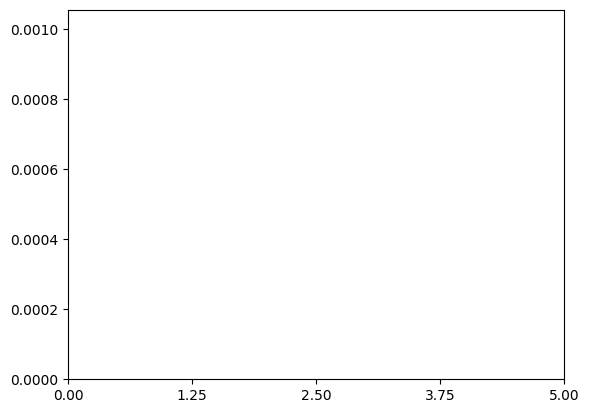

In [15]:
import torch
import matplotlib.pyplot as plt
dummy_model = torch.nn.Linear(2, 1)
dummy_optimizer = torch.optim.SGD(dummy_model.parameters(), lr=0.001)
dummy_scheduler = scheduler(dummy_optimizer)
lrs = []

print("scheduler: ")
for k, v in dummy_scheduler.state_dict().items():
    print(f"\t{k}: {v}")

for i in range(cfg["N_EPOCHS"]):
    dummy_optimizer.step()
    lrs.append(dummy_optimizer.param_groups[0]["lr"])
#     print("Factor = ",i," , Learning Rate = ",optimizer.param_groups[0]["lr"])
    dummy_scheduler.step()

plt.plot(lrs)

dim = 5
xticks = (cfg["N_EPOCHS"] - 1) // dim + 1
plt.plot(lrs)
plt.xticks(np.linspace(0, xticks*dim, dim))
plt.ylim(bottom=0)
plt.xlim(left=0)

In [16]:
#papermill_description=BEFORE_TRAIN
import os
from datetime import datetime

# split basename from output path
save_folder = get_save_folder(cfg["PAPERMILL_OUTPUT_PATH"], cfg["CTIME_STR"])
print(f"CTIME_STR: {cfg['CTIME_STR']}")

if not os.path.exists(save_folder):
    os.makedirs(save_folder)
print(f"Saving to: {save_folder}")

CTIME_STR: 2024-01-10-02-36-21
Saving to: ./2024-01-10-02-36-21-None


In [17]:
%%time
import gc
import json

history = pd.DataFrame()
for epoch in range(cfg["N_EPOCHS"]):
    torch.cuda.empty_cache()
    gc.collect()
    train_model(epoch=epoch, 
                n_epochs=cfg["N_EPOCHS"],
                model=model,
                train_loader=train_loader,
                optimizer=optimizer, 
                scheduler=base_scheduler,
                criterion=partial_criterion,
                switch_loss_epoch=cfg["SWITCH_LOSS_EPOCH"],
                history=history, 
                device=device, 
                tqdm_disabled=cfg["TQDM_DISABLED"])
    evaluate_model(epoch=epoch,
                   model=model, 
                   dev_loader=dev_loader, 
                   criterion=partial_criterion,
                   switch_loss_epoch=cfg["SWITCH_LOSS_EPOCH"],
                   history=history, 
                   device=device)
    torch.save(model.state_dict(), os.path.join(save_folder, f"model_epoch_{epoch}.pth"))


history.to_csv(os.path.join(save_folder, "history.csv"))

# save all parameters
with open(os.path.join(save_folder, "config.json"), "w") as f:
    json.dump(cfg, f, indent=4)

  0%|          | 0/479 [00:00<?, ?it/s]

  8%|▊         | 38/479 [00:43<08:24,  1.14s/it]


KeyboardInterrupt: 

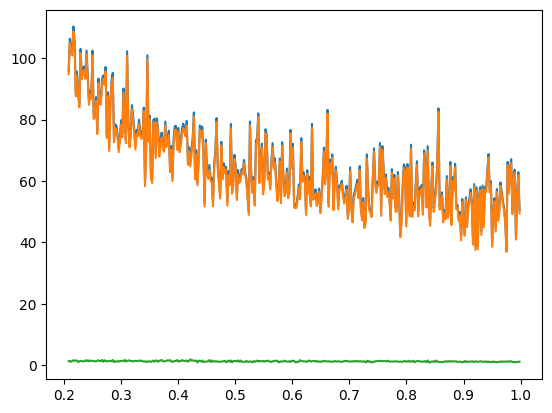

In [ ]:
history['train_loss'].iloc[100:].plot();
history['train_mask_loss'].iloc[100:].plot();
history['train_regr_loss'].iloc[100:].plot();
plt.show()

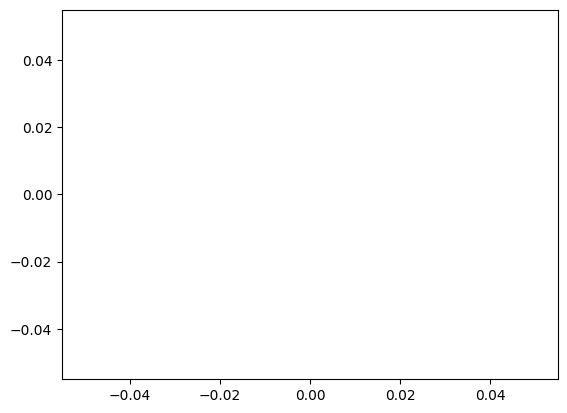

In [ ]:
series = history.dropna()['dev_loss']
plt.plot(series.index, series, label='dev_loss');
series2 = history.dropna()['dev_mask_loss']
plt.plot(series2.index, series2, label='dev_mask_loss');
series3 = history.dropna()['dev_regr_loss']
plt.plot(series3.index, series3, label='dev_regr_loss');
plt.show()

torch.Size([3, 320, 1024])
(320, 1024, 3)


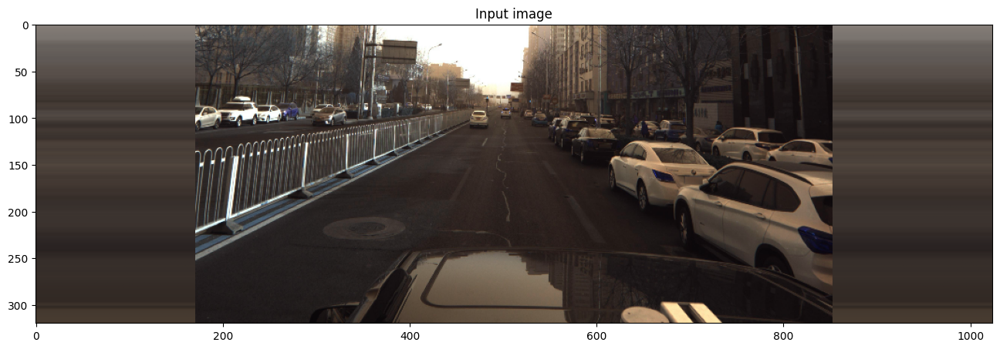

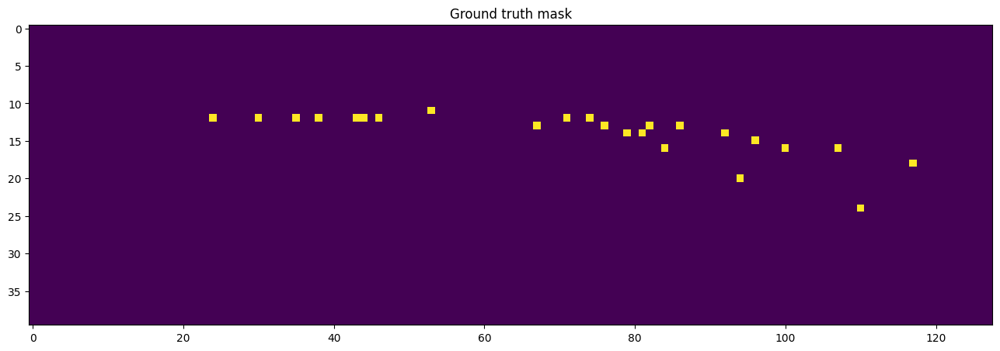

/tmp/ipykernel_2549562/1282337708.py:16: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  output = model(torch.tensor(img[None]).to(device))


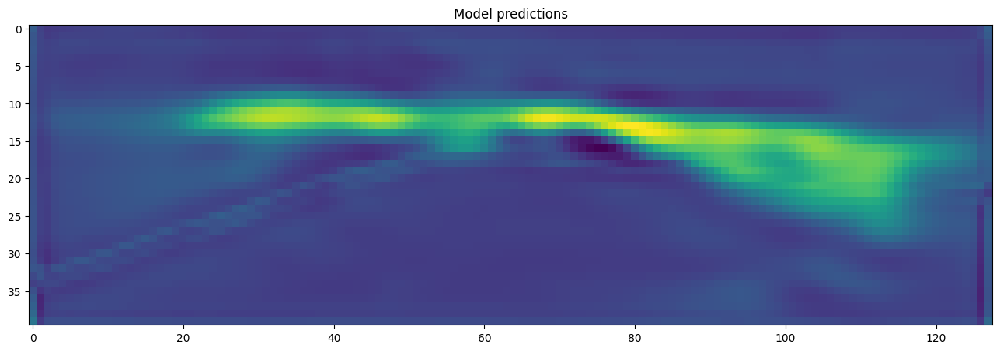

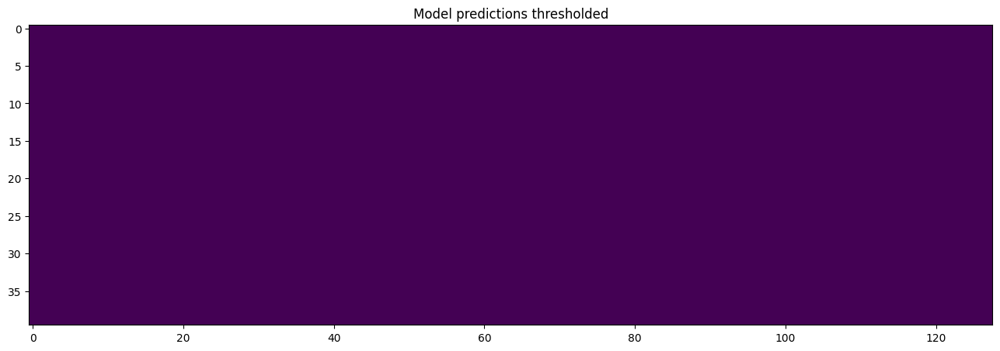

In [ ]:
img, mask, regr = dev_dataset[0]

plt.figure(figsize=(16,16))
plt.title('Input image')
print(img.shape)
show_img = np.rollaxis(torch.Tensor.numpy(img), 0, 3)
print(show_img.shape)
plt.imshow(show_img)
plt.show()

plt.figure(figsize=(16,16))
plt.title('Ground truth mask')
plt.imshow(mask)
plt.show()

output = model(torch.tensor(img[None]).to(device))
logits = output[0,0].data.cpu().numpy()

plt.figure(figsize=(16,16))
plt.title('Model predictions')
plt.imshow(logits)
plt.show()

plt.figure(figsize=(16,16))
plt.title('Model predictions thresholded')
plt.imshow(logits > 0)
plt.show()

torch.Size([3, 320, 1024]) (40, 128) (7, 40, 128)


/home/jichuanh/deep/CarNet/visualize.py:73: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  output = model(torch.tensor(img[None]).to(device)).data.cpu().numpy()


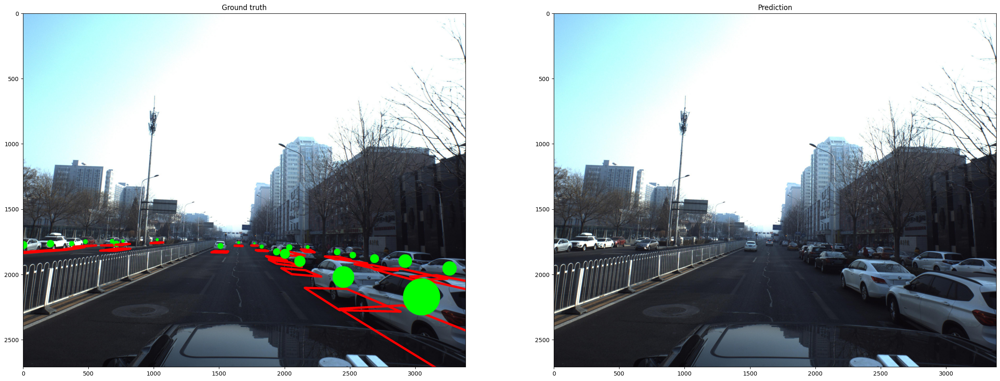

torch.Size([3, 320, 1024]) (40, 128) (7, 40, 128)


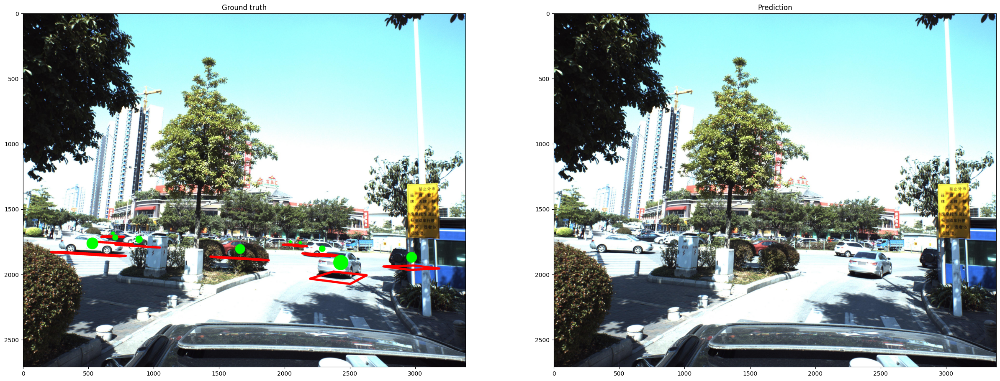

torch.Size([3, 320, 1024]) (40, 128) (7, 40, 128)


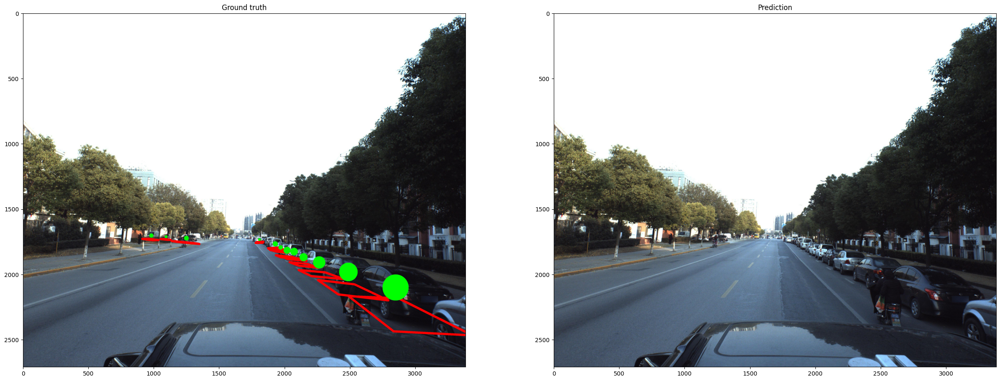

torch.Size([3, 320, 1024]) (40, 128) (7, 40, 128)


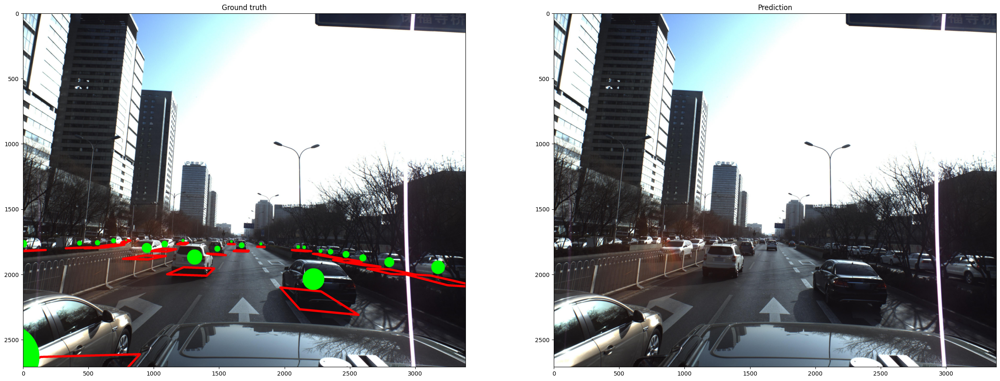

torch.Size([3, 320, 1024]) (40, 128) (7, 40, 128)


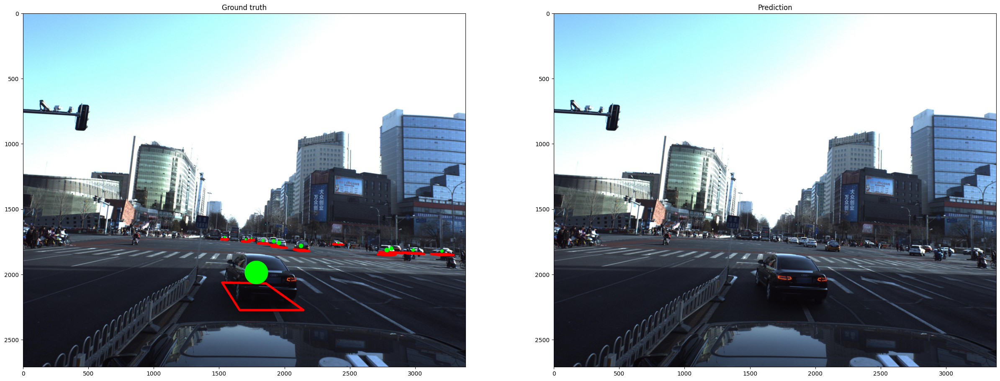

torch.Size([3, 320, 1024]) (40, 128) (7, 40, 128)


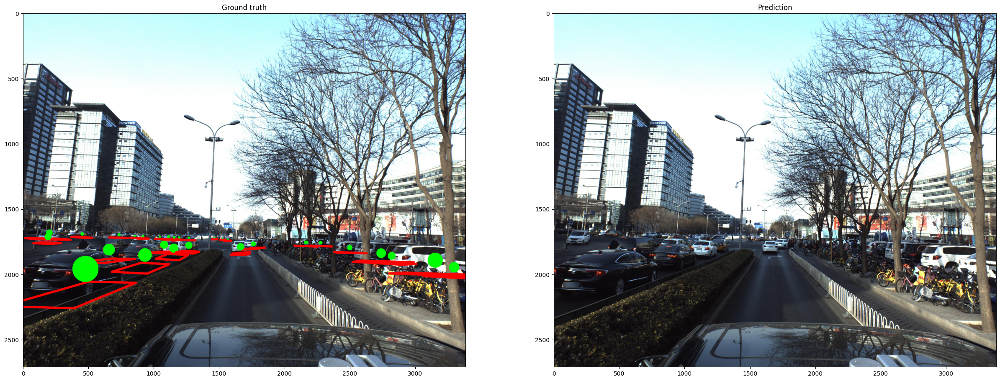

torch.Size([3, 320, 1024]) (40, 128) (7, 40, 128)


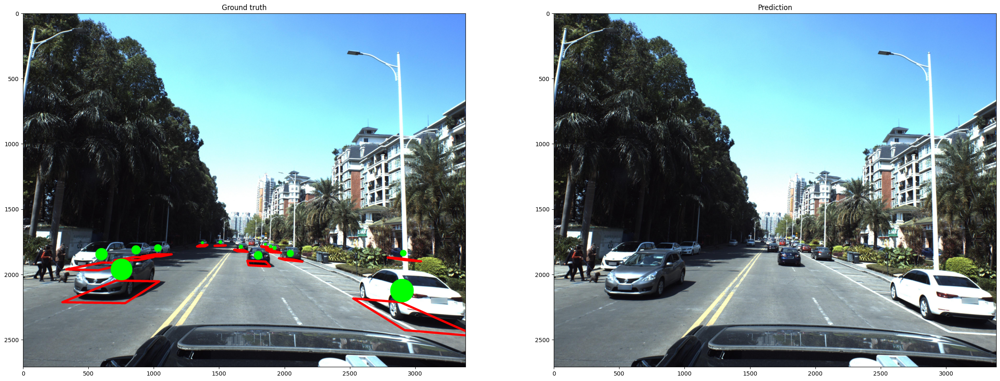

torch.Size([3, 320, 1024]) (40, 128) (7, 40, 128)


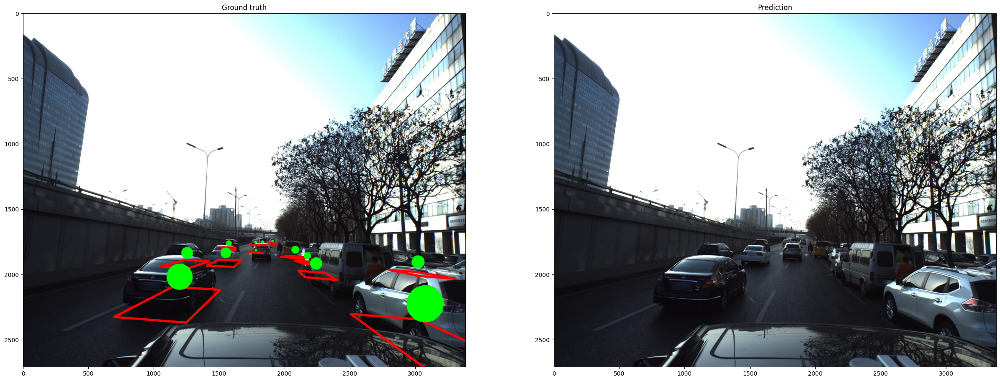

In [ ]:
import torch
import gc
from visualize import visualize_model
# def visualize_model(model, dataset, image_path_format, num_image=8):
#     torch.cuda.empty_cache()
#     gc.collect()

#     torch.cuda.empty_cache()

#     model.eval()
#     for idx in range(num_image):
#         img, mask, regr = dataset[idx]
#         print(img.shape, mask.shape, regr.shape)
        
#         output = model(torch.tensor(img[None]).to(device)).data.cpu().numpy()
#         coords_pred = extract_coords(output[0], channel_first=True)
#         coords_true = extract_coords(np.concatenate([mask[None], regr], 0), channel_first=True)
        
#         img = imread(image_path_format.format(df_dev['ImageId'].iloc[idx]))
#         fig, axes = plt.subplots(1, 2, figsize=(30,30))
#         axes[0].set_title('Ground truth')
#         axes[0].imshow(visualize(img, coords_true))
#         axes[1].set_title('Prediction')
#         axes[1].imshow(visualize(img, coords_pred))
#         plt.show()



visualize_model(model=model,
                dataset=dev_dataset,
                dataset_df=df_dev,
                image_path_format=train_images_dir,
                configured_utils=configured_utils)

torch.Size([3, 320, 1024]) (40, 128) (7, 40, 128)
point is behind camera


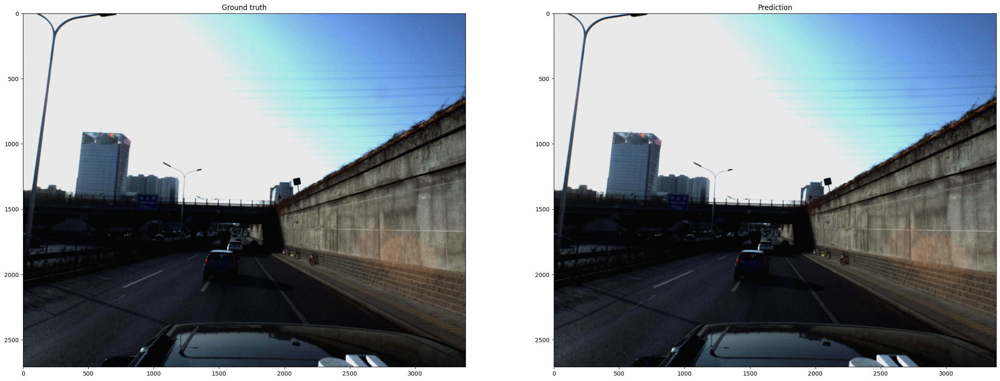

torch.Size([3, 320, 1024]) (40, 128) (7, 40, 128)
point is behind camera


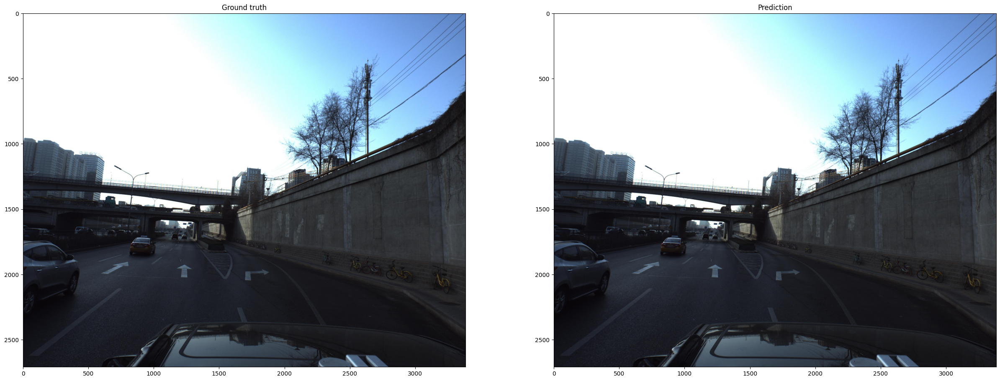

torch.Size([3, 320, 1024]) (40, 128) (7, 40, 128)
point is behind camera


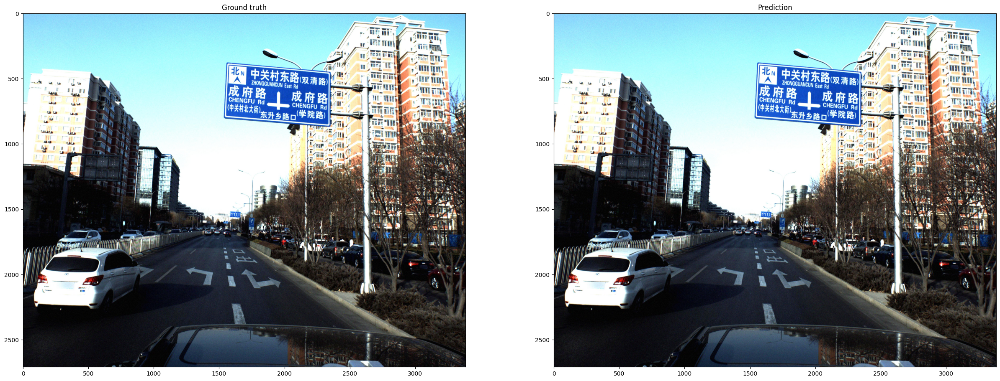

torch.Size([3, 320, 1024]) (40, 128) (7, 40, 128)
point is behind camera


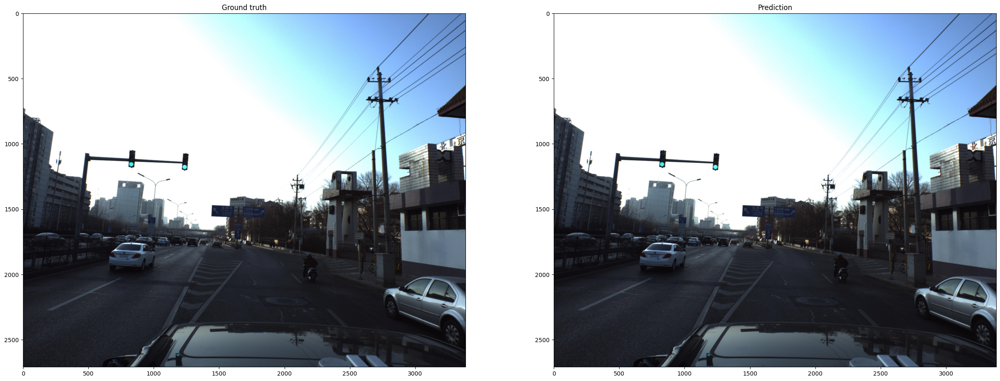

torch.Size([3, 320, 1024]) (40, 128) (7, 40, 128)
point is behind camera


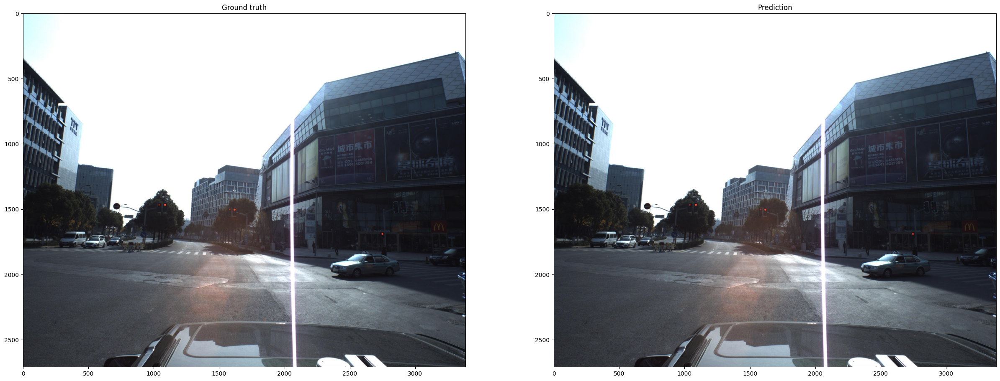

torch.Size([3, 320, 1024]) (40, 128) (7, 40, 128)
point is behind camera


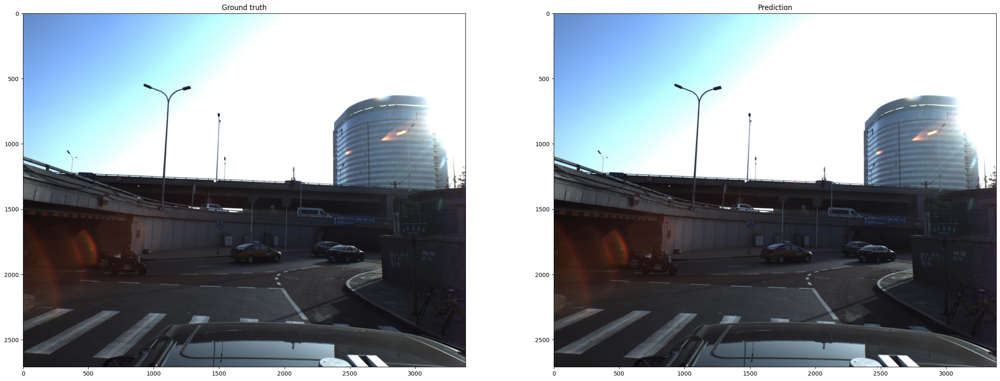

torch.Size([3, 320, 1024]) (40, 128) (7, 40, 128)
point is behind camera


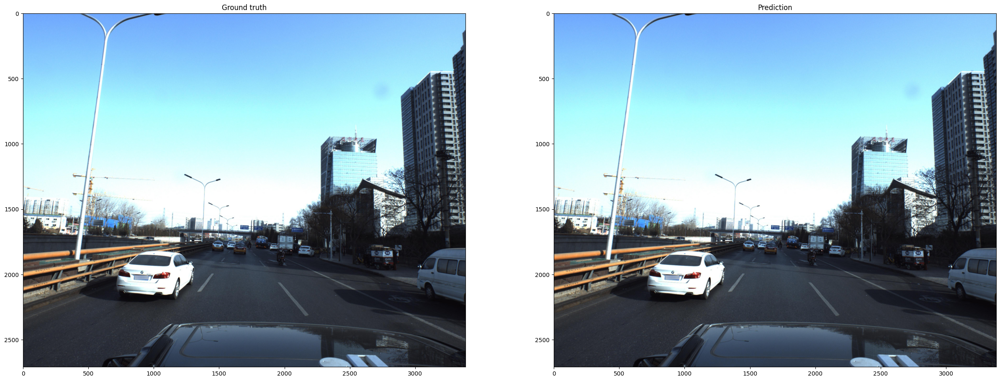

torch.Size([3, 320, 1024]) (40, 128) (7, 40, 128)
point is behind camera


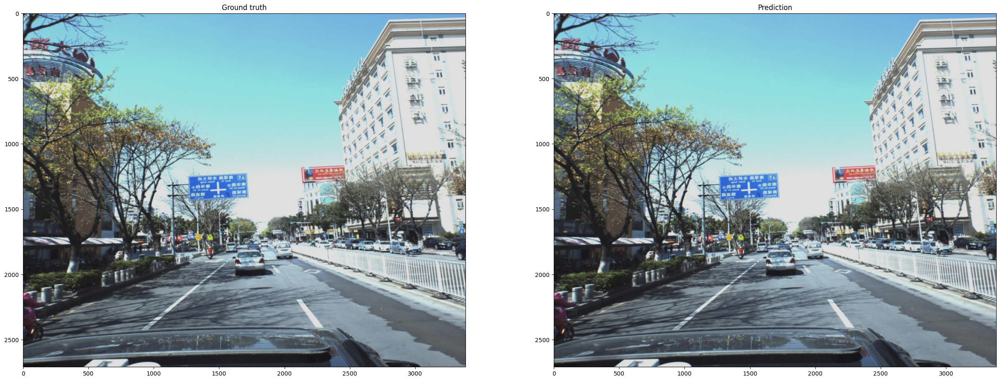

In [ ]:
# visualize test set
visualize_model(model = model,
                dataset = test_dataset,
                dataset_df = df_test,
                image_path_format = test_images_dir,
                configured_utils=configured_utils)

In [ ]:
import torch
from torch.utils.data import DataLoader
import os

def test_model(model, test_dataset, tqdm_disabled=TQDM_DISABLED):
    predictions = []

    test_loader = DataLoader(dataset=test_dataset, batch_size=cfg["BATCH_SIZE"], shuffle=False, num_workers=cfg["BATCH_SIZE"])

    model.eval()

    for img, _, _ in tqdm(test_loader, disable=tqdm_disabled):
        with torch.no_grad():
            output = model(img.to(device))
        output = output.data.cpu().numpy()
        for out in output:
            coords = configured_utils.extract_coords(out, channel_first=True)
            s = coords2str(coords)
            predictions.append(s)
    
    return predictions

def prepare_submission(prediction, submission_basename):
    test = pd.read_csv(PATH + 'sample_submission.csv')
    test['PredictionString'] = prediction
    prediction_file = os.path.join(save_folder, f'{submission_basename}.csv')
    test.to_csv(prediction_file, index=False)
    print(test.head())
    return prediction_file

def submit(prediction_file, extra_note = None):
    note = ", ".join([f"{k}: {v}" for k, v in sorted(cfg.items())] + [f"extra_note: {extra_note}"])
    !kaggle competitions submit -c pku-autonomous-driving -f {prediction_file} -m "{note}"

def test_model_and_submit(model, test_dataset, submission_basename, extra_note=None, tqdm_disabled=cfg["TQDM_DISABLED"]):
    predictions = test_model(model, test_dataset, tqdm_disabled=tqdm_disabled)
    prediction_file = prepare_submission(predictions, submission_basename)
    submit(prediction_file, extra_note)

In [ ]:
from datetime import datetime

predictions = test_model(model, test_dataset)
prediction_file = prepare_submission(predictions, 'prediction')
if cfg["SUBMIT"]:
    submit(prediction_file)

100%|██████████| 253/253 [01:08<00:00,  3.68it/s]


        ImageId PredictionString
0  ID_18fb86d04                 
1  ID_ce06d4dc1                 
2  ID_afe07078f                 
3  ID_37caf75aa                 
4  ID_7655363ca                 


In [ ]:
# TODO: This has problem

# submit two extra models
# with lowest dev loss
# dev_history = history.dropna()
# idx = dev_history['dev_loss'].idxmin()
# idx1 = dev_history.index.get_loc(idx)
# print("dev history len: ", len(dev_history))
# condition = idx1 < len(dev_history) and idx1 + 1 != len(dev_history)
# if condition:
#     print(f"idx1: {idx1}")
#     model.load_state_dict(torch.load(os.path.join(save_folder, f"model_epoch_{idx1}.pth")))
    
#     if cfg["SUBMIT"]:
#         extra_note = f'lowest dev loss: {dev_history["dev_loss"].iloc(idx1)}'
#         predictions = test_model(model, test_dataset)
#         prediction_file = prepare_submission(predictions, 'prediction_lowest_test_loss')
#         submit(prediction_file, extra_note)
        
# if condition:
#     visualize_model(model, dev_dataset, train_images_dir)
    
# and one between lowest and last epoch
# idx2 = int((len(history) + idx1) / 2)
# if idx2 != idx1 and idx2 + 1 != len(history):
#     print(f"idx2: {idx2}")
    # model.load_state_dict(torch.load(os.path.join(save_folder, f"model_epoch_{idx2}.pth")))
    # visualize_model(model, dev_dataset, train_images_dir)
    # if cfg["SUBMIT"]:
    #     test_model_and_submit(model, test_dataset, f'prediction_middle_test_loss', f'middle dev loss: {history["dev_loss"].iloc[idx2]}')


In [ ]:
def expand_df(df, PredictionStringCols):
    df = df.dropna().copy()
    df['NumCars'] = [int((x.count(' ')+1)/7) for x in df['PredictionString']]

    image_id_expanded = [item for item, count in zip(df['ImageId'], df['NumCars']) for i in range(count)]
    prediction_strings_expanded = df['PredictionString'].str.split(' ',expand = True).values.reshape(-1,7).astype(float)
    prediction_strings_expanded = prediction_strings_expanded[~np.isnan(prediction_strings_expanded).all(axis=1)]
    df = pd.DataFrame(
        {
            'ImageId': image_id_expanded,
            PredictionStringCols[0]:prediction_strings_expanded[:,0],
            PredictionStringCols[1]:prediction_strings_expanded[:,1],
            PredictionStringCols[2]:prediction_strings_expanded[:,2],
            PredictionStringCols[3]:prediction_strings_expanded[:,3],
            PredictionStringCols[4]:prediction_strings_expanded[:,4],
            PredictionStringCols[5]:prediction_strings_expanded[:,5],
            PredictionStringCols[6]:prediction_strings_expanded[:,6]
        })
    return df

def TranslationDistance(p,g, abs_dist = False):
    dx = p['x'] - g['x']
    dy = p['y'] - g['y']
    dz = p['z'] - g['z']
    diff0 = (g['x']**2 + g['y']**2 + g['z']**2)**0.5
    diff1 = (dx**2 + dy**2 + dz**2)**0.5
    if abs_dist:
        diff = diff1
    else:
        diff = diff1/diff0
    return diff

def RotationDistance(p, g):
    true=[ g['pitch'] ,g['yaw'] ,g['roll'] ]
    pred=[ p['pitch'] ,p['yaw'] ,p['roll'] ]
    q1 = R.from_euler('xyz', true)
    q2 = R.from_euler('xyz', pred)
    diff = R.inv(q2) * q1
    W = np.clip(diff.as_quat()[-1], -1., 1.)
    
    # in the official metrics code:
    # https://www.kaggle.com/c/pku-autonomous-driving/overview/evaluation
    #   return Object3D.RadianToDegree( Math.Acos(diff.W) )
    # this code treat θ and θ+2π differntly.
    # So this should be fixed as follows.
    W = (acos(W)*360)/pi
    if W > 180:
        W = 360 - W
    return W

In [ ]:
thres_tr_list = [0.1, 0.09, 0.08, 0.07, 0.06, 0.05, 0.04, 0.03, 0.02, 0.01]
thres_ro_list = [50, 45, 40, 35, 30, 25, 20, 15, 10, 5]

def check_match(idx):
    keep_gt=False
    thre_tr_dist = thres_tr_list[idx]
    thre_ro_dist = thres_ro_list[idx]
    train_dict = {imgID:str2coords(s, names=['carid_or_score', 'pitch', 'yaw', 'roll', 'x', 'y', 'z']) for imgID,s in zip(train_df['ImageId'],train_df['PredictionString'])}
    valid_dict = {imgID:str2coords(s, names=['pitch', 'yaw', 'roll', 'x', 'y', 'z', 'carid_or_score']) for imgID,s in zip(valid_df['ImageId'],valid_df['PredictionString'])}
    result_flg = [] # 1 for TP, 0 for FP
    scores = []
    MAX_VAL = 10**10
    for img_id in valid_dict:
        for pcar in sorted(valid_dict[img_id], key=lambda x: -x['carid_or_score']):
            # find nearest GT
            min_tr_dist = MAX_VAL
            min_idx = -1
            for idx, gcar in enumerate(train_dict[img_id]):
                tr_dist = TranslationDistance(pcar,gcar)
                if tr_dist < min_tr_dist:
                    min_tr_dist = tr_dist
                    min_ro_dist = RotationDistance(pcar,gcar)
                    min_idx = idx
                    
            # set the result
            if min_tr_dist < thre_tr_dist and min_ro_dist < thre_ro_dist:
                if not keep_gt:
                    train_dict[img_id].pop(min_idx)
                result_flg.append(1)
            else:
                result_flg.append(0)
            scores.append(pcar['carid_or_score'])
    
    return result_flg, scores

In [ ]:
#validation_prediction = df_dev
valid_df = pd.read_csv('val_predictions.csv')
expanded_valid_df = expand_df(valid_df, ['pitch','yaw','roll','x','y','z','Score'])
valid_df = valid_df.fillna('')

train_df = pd.read_csv(PATH + 'train.csv')
train_df = train_df[train_df.ImageId.isin(valid_df.ImageId.unique())]
# data description page says, The pose information is formatted as
# model type, yaw, pitch, roll, x, y, z
# but it doesn't, and it should be
# model type, pitch, yaw, roll, x, y, z
expanded_train_df = expand_df(train_df, ['model_type','pitch','yaw','roll','x','y','z'])

max_workers = 10
n_gt = len(expanded_train_df)
ap_list = []
p = Pool(processes=max_workers)
for result_flg, scores in p.imap(check_match, range(10)):
    if np.sum(result_flg) > 0:
        n_tp = np.sum(result_flg)
        recall = n_tp/n_gt
        ap = average_precision_score(result_flg, scores)*recall
    else:
        ap = 0
    ap_list.append(ap)
map = np.mean(ap_list)
print('map:', map)